<a href="https://colab.research.google.com/github/sousagomide/stable_diffusion/blob/main/secao03_explorando_prompts.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers==0.11.1
!pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers

In [ ]:
import torch
from diffusers import StableDiffusionPipeline

In [ ]:
sd2 = StableDiffusionPipeline.from_pretrained('stabilityai/stable-diffusion-2-1', torch_dtype=torch.float16)
sd2.safety_checker = lambda images, clip_input: (images, False)
sd2 = sd2.to('cuda')
sd2.enable_attention_slicing()
sd2.enable_xformers_memory_efficient_attention()

In [ ]:
seed = 777

In [ ]:
from PIL import Image # Biblioteca para gerar imagens

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols
  w, h = imgs[0].size
  w, h = int(w * scale), int(h * scale)
  grid = Image.new('RGB', size = (cols * w, rows * h))
  grid_w, grid_h = grid.size
  for i, img in enumerate(imgs):
    img = img.resize((w, h), Image.ANTIALIAS)
    grid.paste(img, box=(i % cols * w, i // cols * h)) # Questão de redimensionamento
  return grid

# Sujeito / objeto

* O assunto/objeto é o que você quer ver na imagem
* Um erro comum é não escrever o suficiente sobre os assuntos, o que deixa muito espaço para a imaginação. Como você quer que pareça? Alguma palavra para descrevê-la que limitaria sua imagem? O que veste?
* Temos que dizer exatamente o que queremos
* Um truque comum é usar nomes de celebridades, tem um efeito forte para controlar a aparência

  0%|          | 0/50 [00:00<?, ?it/s]

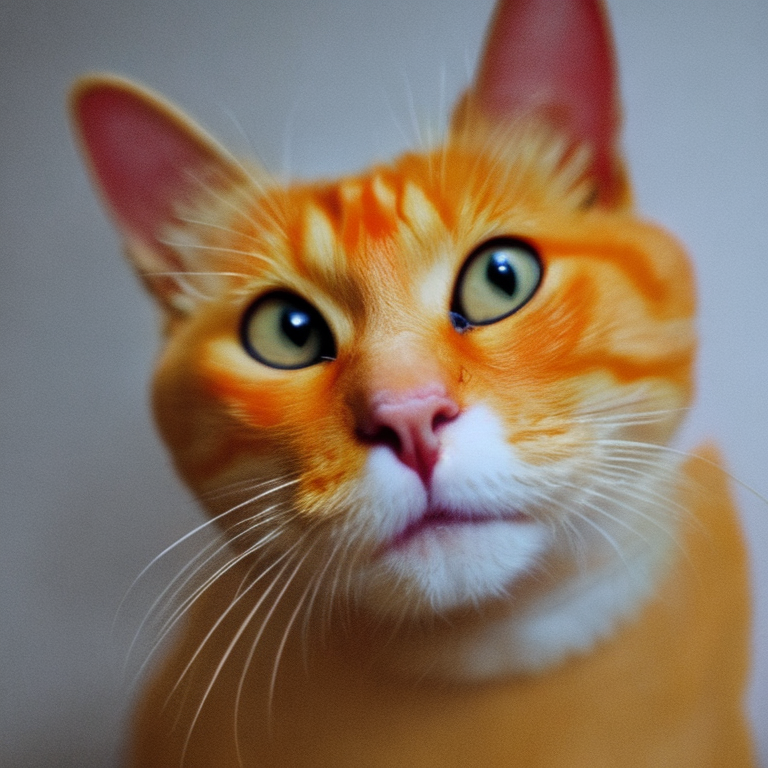

In [ ]:
prompt = 'an orange cat'
generator = torch.Generator('cuda').manual_seed(seed)
img = sd2(prompt, generator = generator).images[0]
img

# Ação e local

* O que está fazendo? O que está vestindo? Está de pé, correndo ou flutuando no ar? Qual é o cenário e a cena de fundo?

  0%|          | 0/50 [00:00<?, ?it/s]

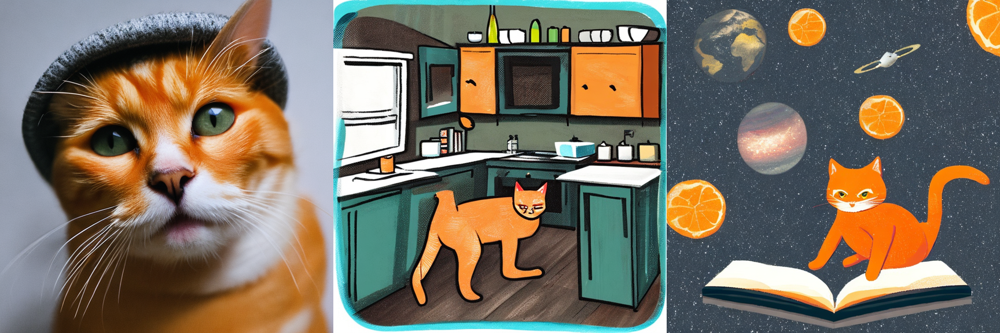

In [ ]:
prompt = ['an orange cat wearing a hat',
          'an orange cat reading a book in the kitchen',
          'an orange cat reading a book in space']
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompt, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompt), scale = 0.75)
grid

# Meio / tipo

* O meio (medium), ou tipo, é o material usado para fazer a imagem ou obra de arte. Alguns exemplos são: ilustração, fotografia, pintura a óleo e renderização 3D.
* O meio tem um forte efeito e uma palavra-chave sozinha pode mudar drasticamente o estilo

Palavras-chave úteis

> Painting, Photo, Drawing, 3D redering, etc

> Mais específicos: Oil painting, watercolor painting, Portrait, Sketch, Digital painting, Concept art, Ultra realistic illustration, Underwater portrait, Underwater steampunk



  0%|          | 0/50 [00:00<?, ?it/s]

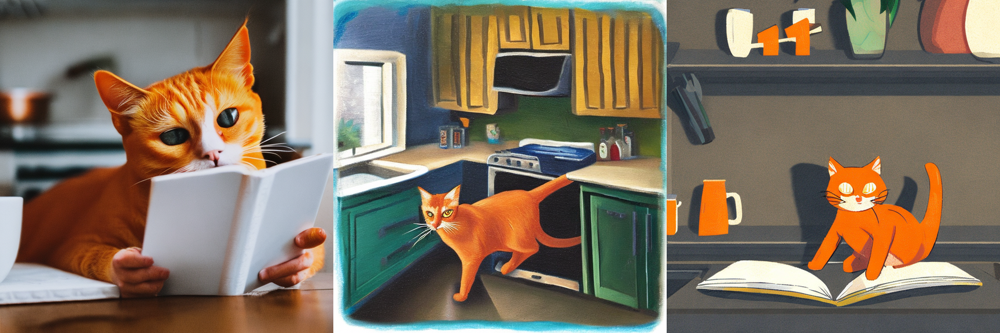

In [ ]:
prompt = ['photo of an orange cat reading a book in the kitchen',
          'oil painting of an orange cat reading a book in the kitchen',
          'concept art of an orange cat reading a book in the kitchen']
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompt, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompt), scale = 0.75)
grid

['orange cat reading a book in space, Oil painting', 'orange cat reading a book in space, digital painting', 'orange cat reading a book in space, Underwater steampunk']


  0%|          | 0/50 [00:00<?, ?it/s]

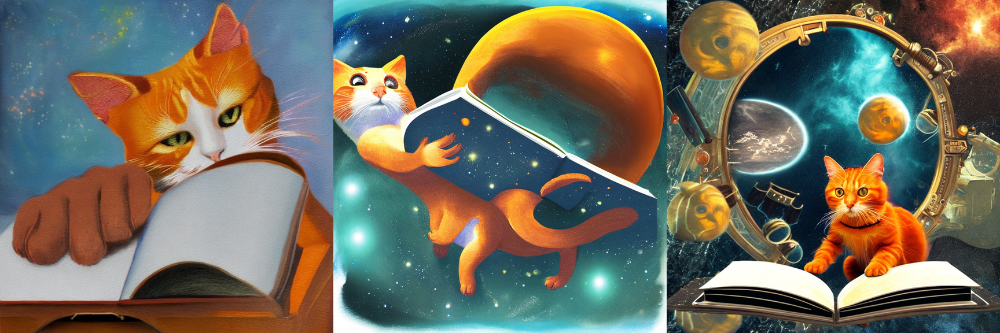

In [ ]:
base = 'orange cat reading a book in space'
m_ = [', Oil painting', ', digital painting', ', Underwater steampunk']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompt), scale = 0.75)
grid

# Estilo

 * Refere-se ao estilo artístico da imagem
 * Exemplos: impressionista, surrealista, arte pop, etc
 * As vezes, não nota-se muita diferença se adicionar mais termos específicos. Isso pode acontecer especialmente em casos nos quais o efeito das palavras-chave usadas já estavam implícitos pelos termos usados anteriormente, como do meio ou nomes de artistas

Palavras-chave úteis
 > realistic, hypeerrealistic, pop-art, modernist, art nouveau, surrealist, etc

['orange cat reading a book in space, Modernist', 'orange cat reading a book in space, impressionist', 'orange cat reading a book in space, realistic']


  0%|          | 0/50 [00:00<?, ?it/s]

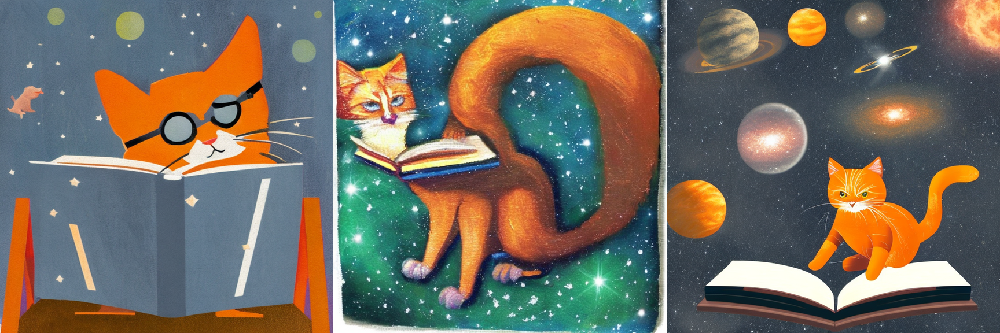

In [ ]:
base = 'orange cat reading a book in space'
m_ = [', Modernist', ', impressionist', ', realistic']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompt), scale = 0.75)
grid

# Cores

* É possível controlar a cor geral da imagem adicionando palavras-chave de cores ou tonalidades
* Por exemplo, se quisermos adicionar um pouco de cor dourada à imagem podemos usar o termo gold ou ainda "iridescent gold", que dará um tom de dourado bem brilhoso

Palavras-chave úteis
> vivid, [cor] ou tones ou [cor] colors, bw (preto e branco), vintage, gold, silver, etc

['a photograph of an orange cat reading a book in space, realistic, purple', 'a photograph of an orange cat reading a book in space, realistic, red colors', 'a photograph of an orange cat reading a book in space, realistic, black and white']


  0%|          | 0/50 [00:00<?, ?it/s]

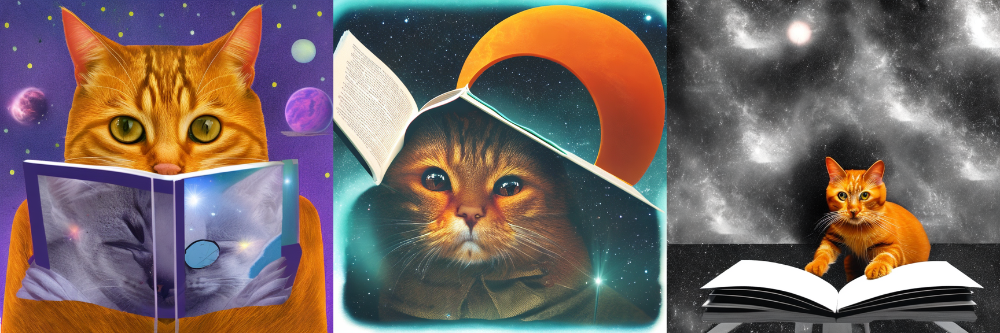

In [ ]:
base = 'a photograph of an orange cat reading a book in space, realistic'
m_ = [', purple', ', red colors', ', black and white']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompt), scale = 0.75)
grid

# Artistas

Palavras-chave úteis
> Van Gogh, John Collier, Monet, Alphonse Mucha, Salvador Dali, Rembrandt, Da Vinci, etc

Bônus: Acesse a página https://www.urania.ai/top-sd-artists para ver uma lista com milhares de artistas representados no modelo do Stable Diffusion

['a painting of an orange cat reading a book in space, realistic, by Van Gogh', 'a painting of an orange cat reading a book in space, realistic, by Sandro Botticelli', 'a painting of an orange cat reading a book in space, realistic, by Romero Britto', 'a painting of an orange cat reading a book in space, realistic, by Da Vinci']


  0%|          | 0/50 [00:00<?, ?it/s]

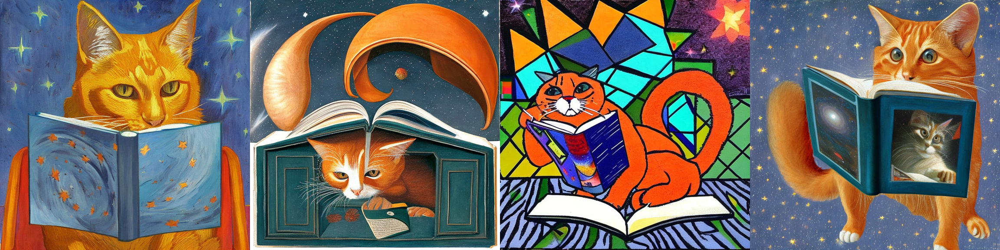

In [16]:
base = 'a painting of an orange cat reading a book in space, realistic'
m_ = [', by Van Gogh', ', by Sandro Botticelli', ', by Romero Britto', ', by Da Vinci']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompts), scale = 0.75)
grid

# Resolução

* Representa o quão nítida e detalhada a imagem será. Podemos adicionar palavras-chave highly detailed e sharp focus, por exemplo. Por outro lado, se quiséssemos uma imagem borrada ou com efeito de movimento/borrão poderíamos colocar blurred, por exemplo.

Palavras-chave úteis
> highly detailed, unreal engine, sharp focus, hd, 4k ou 8k, vray (para renderizações realisticas 3D, funciona melhor com paisagens)

['a futuristic city on another planet at dawn, unreal engine', 'a futuristic city on another planet at dawn, by sharp focus', 'a futuristic city on another planet at dawn, by vray']


  0%|          | 0/50 [00:00<?, ?it/s]

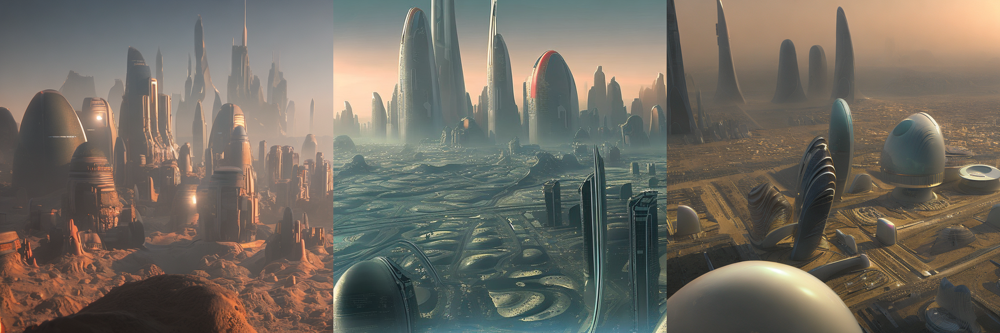

In [17]:
base = 'a futuristic city on another planet at dawn'
m_ = [', unreal engine', ', by sharp focus', ', by vray']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompts), scale = 0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

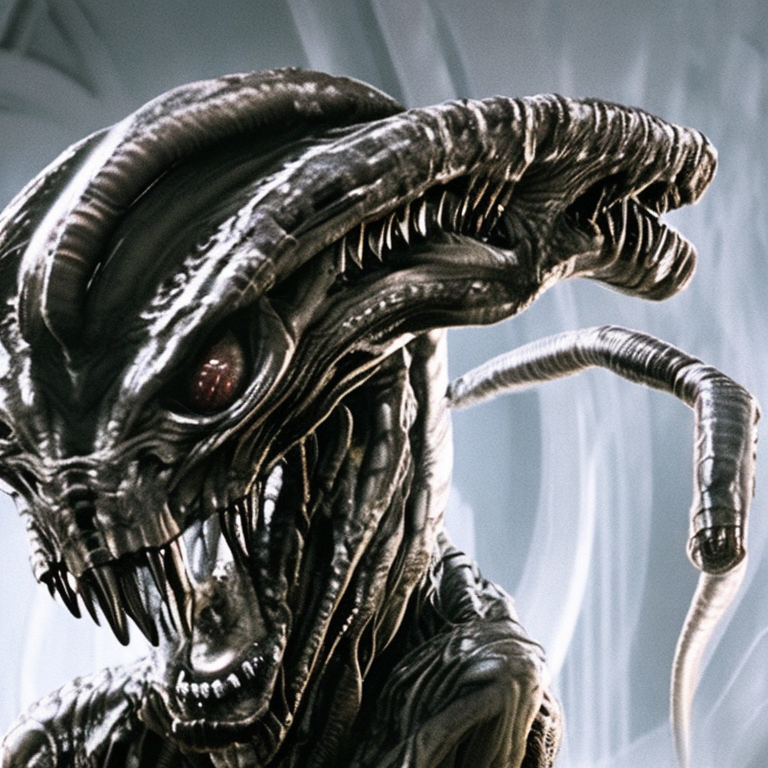

In [24]:
prompts = 'an xenomorph, from movie Aliens'
generator = torch.Generator('cuda').manual_seed(seed)
img = sd2(prompts, generator = generator).images[0]
img

# Site

* São os "showcases" de artes e imagens gráficas no geral, como Artstation ou Deviant Art, nos quais agregam-se muitas imagens de gêneroos distintos. Usar esses termos em um prompt é uma maneira segura de direcionar a imagem para esses estilos, no caos, estilo das artes que você encontraria nesses sites.
* Outro exemplo: pixabay é um site de recursos gráficos e principalmente fotos, portanto, se estiver com certa dificuldade de conseguir fotos mais realisticas pode passar o nome do site do prompt. Ou ainda o termo unsplash, um site que é apenas de fotos.

Palavras-chave úteis
> artstation, pixabay, unsplash e pexels, pixiv

['an orange cat reading a book in space, realistic, unsplash', 'an orange cat reading a book in space, realistic, pixabay', 'an orange cat reading a book in space, realistic, pixiv']


  0%|          | 0/50 [00:00<?, ?it/s]

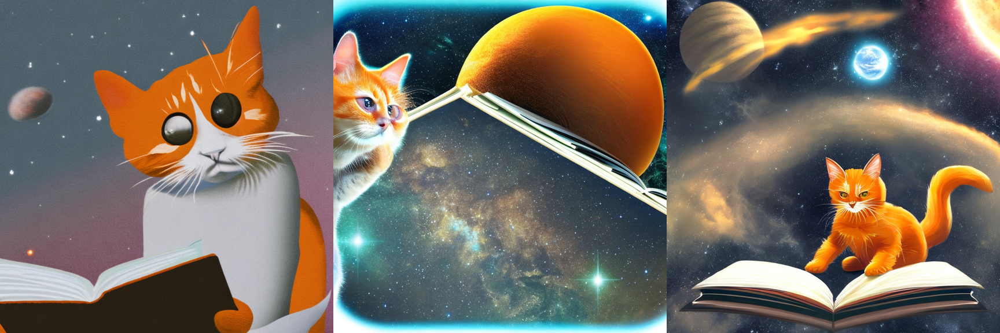

In [25]:
base = 'an orange cat reading a book in space, realistic'
m_ = [', unsplash', ', pixabay', ', pixiv']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompts), scale = 0.75)
grid

# Iluminação

['photograph of an orange cat reading a book in space, realistic, unsplash, cinematic lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, rim lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, sunset']


  0%|          | 0/50 [00:00<?, ?it/s]

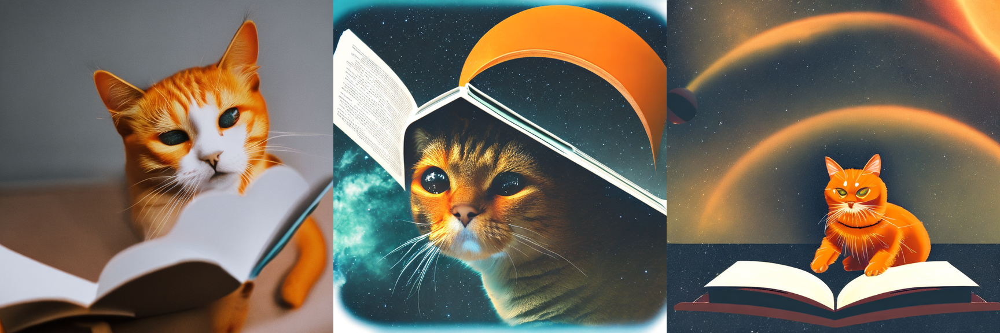

In [26]:
base = 'photograph of an orange cat reading a book in space, realistic, unsplash'
m_ = [', cinematic lighting', ', rim lighting', ', sunset']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompts), scale = 0.75)
grid

# Outros

['photograph of an orange cat reading a book in space, realistic, unsplash, stunningly beautiful, award winning photo, tilt-shift', 'photograph of an orange cat reading a book in space, realistic, dramatic', 'photograph of an orange cat reading a book in space, realistic, low angle shot']


  0%|          | 0/50 [00:00<?, ?it/s]

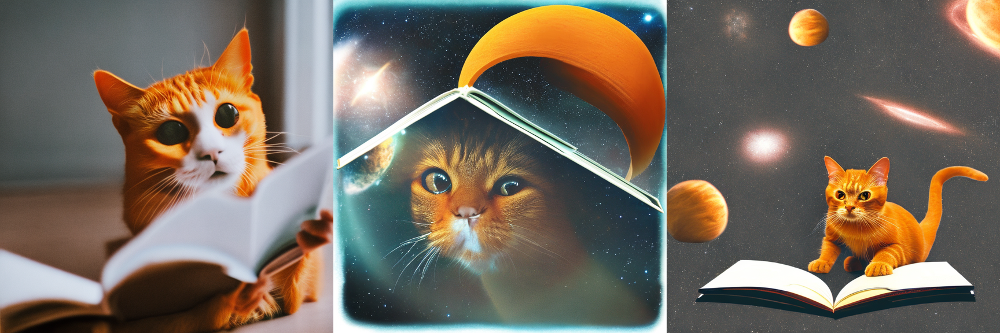

In [27]:
base = 'photograph of an orange cat reading a book in space, realistic'
m_ = [', unsplash, stunningly beautiful, award winning photo, tilt-shift', ', dramatic', ', low angle shot']
prompts = []
for m in m_:
  prompts.append(base + m)
print(prompts)
generator = torch.Generator('cuda').manual_seed(seed)
imgs = sd2(prompts, generator = generator).images
grid = grid_img(imgs, rows = 1, cols = len(prompts), scale = 0.75)
grid